<a href="https://colab.research.google.com/github/cgmeyer/AI-Deep-Learning-Lab-2023/blob/main/MIDRC_Cohort_Building_DLL_RSNA_2023.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Cohort Building Using the MIDRC Data Commons
---
This notebook briefly demonstrates how to use the MIDRC open APIs to build a cohort of MIDRC imaging studies using patient clinical data and AI-research-based annotations in the MIDRC data commons and then access and view the X-ray image files associated with those imaging studies.

All cohort selection possible in the [MIDRC data explorer UI](https://data.midrc.org/explorer) can also be achieved programmatically using API requests. In this notebook, we'll select the same cohort as in the data explorer demo detailed in [these slides](https://docs.google.com/presentation/d/1xZ-shCuGVlLpHb2_CwrYvnQZnYZ3QDCcoNfcUvaxTmE/edit?usp=sharing).

by Chris Meyer, PhD

Manager of Data and User Services at the Center for Translational Data Science at University of Chicago

Presented at the MIDRC RSNA 2023 Deep Learning Lab on November 28, 2023





## 1) Set up Python environment
---


### Download an API key file containing your credentials
---
1) Navigate to the MIDRC data portal in your browser: https://data.midrc.org.
2) Read and accept the DUA (if you haven't already).
3) Navigate to the user profile page: https://data.midrc.org/identity
4) Click on the button "Create API Key" and save the `credentials.json` file somewhere safe


### Set local variables
---
Change the following `cred` variable path to point to your credentials file downloaded from the MIDRC data portal following the instructions above.

In [ ]:
cred = "/content/midrc-credentials.json" # location of your MIDRC credentials, downloaded from https://data.midrc.org/identity by clicking "Create API key" button and saving the credentials.json locally
api = "https://data.midrc.org" # The base URL of the data commons being queried. This shouldn't change for MIDRC.


### Install / Import Python Packages and Scripts

In [ ]:
## The packages below may be necessary for users to install according to the imports necessary in the subsequent cells.

import sys
#!{sys.executable} -m pip install
#!{sys.executable} -m pip install --upgrade pandas
#!{sys.executable} -m pip install --upgrade --ignore-installed PyYAML
#!{sys.executable} -m pip install --upgrade pip
#!{sys.executable} -m pip install --upgrade gen3
#!{sys.executable} -m pip install pydicom
#!{sys.executable} -m pip install --upgrade Pillow
#!{sys.executable} -m pip install psmpy
#!{sys.executable} -m pip install python-gdcm --upgrade
#!{sys.executable} -m pip install pylibjpeg --upgrade

In [ ]:
## Import Python Packages and scripts

import os, subprocess
import pandas as pd
import numpy as np
import pydicom
from PIL import Image
import glob
#import gdcm
#import pylibjpeg

# import some Gen3 packages
import gen3
from gen3.auth import Gen3Auth
from gen3.query import Gen3Query



### Initiate instances of the Gen3 SDK Classes using credentials file for authentication
---
Again, make sure the "cred" directory path variable reflects the location of your credentials file (path variables set above).

In [ ]:
auth = Gen3Auth(api, refresh_file=cred) # authentication class
query = Gen3Query(auth) # query class


## 2) Build Cohorts by Sending Queries to the MIDRC APIs
#### General notes on sending queries:
* There are many ways to query and access metadata for cohort building in MIDRC, but this notebook will focus on using the [Gen3](https://gen3.org) graphQL query service ["guppy"](https://github.com/uc-cdis/guppy/#readme). This is the backend query service that [MIDRC's data explorer GUI](https://data.midrc.org/explorer) uses. So, anything you can do in the explorer GUI, you can do with guppy queries, and more!
* The guppy graphQL service has more functionality than is demonstrated in this simple example. You can find extensive documentation in GitHub [here](https://github.com/uc-cdis/guppy/blob/master/doc/queries.md) in case you'd like to build your own queries from scratch.
* The Gen3 SDK (intialized as `query` above in this notebook) has Python wrapper scripts to make sending queries to the guppy graphQL API simpler. The guppy SDK package can be viewed in GitHub [here](https://github.com/uc-cdis/gen3sdk-python/blob/master/gen3/query.py).
* Guppy queries focus on a particular type of data (cases, imaging studies, files, etc.), which corresponds to the major tabs in [MIDRC's data explorer GUI](https://data.midrc.org/explorer).
* Queries include arguments that are akin to selecting filter values in [MIDRC's data explorer GUI](https://data.midrc.org/explorer).
* To see more documentation about how to use and combine filters with various operator logic (like AND/OR/IN, etc.) see [this page](https://github.com/uc-cdis/guppy/blob/master/doc/queries.md#filter).

---


#### Set query parameters
---
* Here, we'll send a query to the `imaging_study` guppy index, which corresponds to the "Imaging Studies" tab of [MIDRC's data explorer GUI](https://data.midrc.org/explorer).
* The filters defined below can be modified to return different subsets of imaging studies. Here, we'll use rather restrictive parameters so the number of studies returned is small for demonstration purposes.
* If our query request is successful, the API response should be in JSON format, and it should contain a list of patient IDs along with any other patient data we ask for.


In [ ]:
### Set some "imaging_study" query parameters

## mRALE filter: we'll select all imaging studies annotated with an mRALE score greater than or equal to this threshold number
mRALE_threshold = 20

## days from study to positive COVID-19 test filter: we want imaging studies performed within two days after a positive test
min_days_from_study_to_test = -2
max_days_from_study_to_test = 0

## Imaging study modality filter: we select imaging studies with a modality of either DX or CR
study_modalities = ["DX", "CR"]

## Imaging study body part filter: here we select "chest" as the "LOINC system" filter, which is the body part examined
body_part_examined = "Chest"

## Case filters: we will select Hispanic males 70 years of age and older
ethnicity = "Hispanic or Latino"
sex = "Male"
age_threshold = 70

In [ ]:
## Note: the "fields" option defines what fields we want the query to return. If set to "None", returns all available fields.

imaging_studies = query.raw_data_download(
                    data_type="imaging_study",
                    fields=None,
                    filter_object={
                        "AND": [
                            {"=": {"loinc_system": body_part_examined}},
                            {"=": {"sex": sex}},
                            {"=": {"ethnicity": ethnicity}},
                            {">=": {"age_at_index": age_threshold}},
                            {"IN": {"study_modality": study_modalities}},
                            {"nested": {"path": "imaging_study_annotations", ">=": {"midrc_mRALE_score": mRALE_threshold}}},
                            {"AND": [
                                {">=": {"days_from_study_to_pos_covid_test": min_days_from_study_to_test}},
                                {"<=": {"days_from_study_to_pos_covid_test": max_days_from_study_to_test}}
                            ]}
                        ]
                    },
                    sort_fields=[{"submitter_id": "asc"}]
                )

if len(imaging_studies) > 0 and "submitter_id" in imaging_studies[0]:
    imaging_studies_ids = [i['submitter_id'] for i in imaging_studies] ## make a list of the imaging study IDs returned
    print("Query returned {} study IDs.".format(len(imaging_studies)))
    print("Data is a list with rows like this:\n\t {}".format(imaging_studies[0:1]))
else:
    print("Your query returned no data! Please, check that query parameters are valid.")

Query returned 9 study IDs.
Data is a list with rows like this:
	 [{'_imaging_study_id': '5f7b22b2-4566-40e8-bc85-5f9ae79e9181', 'project_id': 'Open-A1', 'submitter_id': '2.16.840.1.114274.1818.514395397152296418914049330214008864917', 'case_ids': ['10008204-RwVMPdTu0EOZV6oE7Rml5Q'], 'age_at_imaging': 71, 'body_part_examined': ['PORT CHEST'], 'days_from_study_to_pos_covid_test': [28, 0], 'days_to_study': 0, 'loinc_code': '36589-0', 'loinc_long_common_name': 'Portable XR Chest AP single view', 'loinc_method': 'XR.portable', 'loinc_system': 'Chest', 'study_description': 'CHEST PORT 1 VIEW (RAD)-CS', 'study_modality': ['CR'], 'study_year_shifted': 'true', 'study_uid': '2.16.840.1.114274.1818.514395397152296418914049330214008864917', 'sex': ['Male'], 'race': ['White'], 'age_at_index': [71], 'index_event': ['First COVID test'], 'zip': ['772'], 'covid19_positive': ['Yes'], 'ethnicity': ['Hispanic or Latino'], 'dataset_submitter_id': ['ACR_20220415', 'ACR_20220218'], 'mr_series_file': 1, 'cr_

In [ ]:
imaging_studies_df = pd.DataFrame(imaging_studies)
display(imaging_studies_df)


,_imaging_study_id,project_id,submitter_id,case_ids,age_at_imaging,body_part_examined,days_from_study_to_pos_covid_test,days_to_study,loinc_code,loinc_long_common_name,...,cr_series_file,dx_series_file,ct_series_file,object_id,data_format,data_type,data_category,imaging_study_annotations,auth_resource_path,days_from_study_to_neg_covid_test
0,5f7b22b2-4566-40e8-bc85-5f9ae79e9181,Open-A1,2.16.840.1.114274.1818.51439539715229641891404...,[10008204-RwVMPdTu0EOZV6oE7Rml5Q],71,[PORT CHEST],"[28, 0]",0,36589-0,Portable XR Chest AP single view,...,1,1,1,"[dg.MD1R/939b1509-5e00-485a-9b81-541e994ee77a,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DICOM Annotation Series File, CR, annotation_...","[{'annotation_method': 'Retrospective_auto', '...",/programs/Open/projects/A1,NaN
1,15f6d9c7-5c1a-41b3-b230-7b678c3d5bcf,Open-R1,1.2.826.0.1.3680043.10.474.419639.210778054999...,[419639-003484],72,[CHEST],"[21, 0]",0,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/1e5c81f3-379b-4f4a-ab3e-f220e21c3d03,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'annotation_method': 'Retrospective_auto', '...",/programs/Open/projects/R1,"[33, 32]"
2,a960e1bc-c81f-4416-ada7-1894eb154931,Open-R1,1.2.826.0.1.3680043.10.474.419639.136347983342...,[419639-005966],72,[CHEST],"[1, -2]",2,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/7ac2682b-db73-44a8-89b8-d12bd7d48adc,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DICOM Annotation Series File, CR, annotation_...","[{'midrc_mRALE_score': 24, '_annotation_id': '...",/programs/Open/projects/R1,NaN
3,8c1fca33-09b8-486e-9497-7c405011d528,Open-R1,1.2.826.0.1.3680043.10.474.419639.125810573309...,[419639-004486],70,[CHEST],"[14, 7, -1, -26]",26,36572-6,XR Chest AP,...,1,2,1,"[dg.MD1R/99d20215-0ead-49eb-9d86-8e67eaa19217,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'annotation_method': 'Retrospective_auto', '...",/programs/Open/projects/R1,"[32, 31, -122, -147]"
4,3a38fd7a-9375-4b16-82a3-6847a7e00754,Open-R1,1.2.826.0.1.3680043.10.474.419639.161896168092...,[419639-004486],70,[CHEST],"[15, 8, 0, -25]",25,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/6bda2df1-6972-4c1b-849a-823cdddea86d,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'annotation_method': 'Retrospective_auto', '...",/programs/Open/projects/R1,"[33, 32, -121, -146]"
5,f73ba2b6-0452-4a6a-9c1a-fb1aaca2a311,Open-R1,1.2.826.0.1.3680043.10.474.419639.140316142430...,[419639-003484],72,[CHEST],"[21, 0]",0,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/8a5a00f6-4b92-4405-a1f5-a66ca756d81c,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'midrc_mRALE_score': 20, '_annotation_id': '...",/programs/Open/projects/R1,"[33, 32]"
6,b9b5a9ee-fe52-4e42-bd4e-15c46aa7ef7e,Open-R1,1.2.826.0.1.3680043.10.474.419639.118613874522...,[419639-004486],70,[CHEST],"[7, 0, -8, -33]",33,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/1258c1a9-e3ea-4847-bfb4-7ea7bc1aa77e,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'annotation_method': 'Retrospective_auto', '...",/programs/Open/projects/R1,"[25, 24, -129, -154]"
7,f7285515-be07-43bd-bc66-dab8ba6a89f2,Open-R1,1.2.826.0.1.3680043.10.474.419639.238877950213...,[419639-005966],72,[CHEST],"[3, 0]",0,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/0320d6e3-9e02-472c-8194-3e530a2b5e9e,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'annotation_method': 'Retrospective_auto', '...",/programs/Open/projects/R1,NaN
8,f7d154dc-1e96-47f5-bb91-8fe668350def,Open-R1,1.2.826.0.1.3680043.10.474.419639.274623828911...,[419639-004486],70,[CHEST],"[40, 33, 25, 0]",0,36572-6,XR Chest AP,...,1,1,1,"[dg.MD1R/1bb654e6-8a1e-49c8-a88a-329ffbe75c35,...","[CSV, DCM]","[MIDRC Annotation, DICOM]","[DX, DICOM Annotation Series File, annotation_...","[{'midrc_mRALE_score': 21, '_annotation_id':

## 3) Send another query to get data file details for our cohort / case ID
---
The `object_id` field in each imaging study record above contains the file identifiers for all files associated with each imaging study, which could include files like third-party annotations. If we simply want to access all files associated with our list of cases, we can use those object_ids.

However, in this example, we'll ask for specific types of files and get more detailed information about each of the files. This is achieved by querying the `data_file` guppy index, which corresponds to the "Data Files" tab of the MIDRC data explorer GUID.

All MIDRC data files, including both images and annotations, are listed in the guppy index "data_file", which is queried in a similar manner to our query of the `imaging_study` index above. The query parameter `data_type` below determines which guppy (Elasticsearch) index we're querying.

To get only `data_file` records that correspond to our imaging study cohort built previously, we'll use the list of study UIDs as a query filter.


### Set 'data_file' query parameters
---
Here, we'll utilize the property `source_node` to filter the list of files for our cohort to only those matching the type of files we're interested in. In this example, we ask only for CR and DX (x-ray) images, which will exclude any other types of files like annotations.

We're also using the property `study_uid` as a filter to restrict the `data_file` records returned down to those associated with the imaging studies in our cohort built above.


In [ ]:
# Build a list of study UIDs to use as a filter in our data_file query
study_uids = [i['study_uid'] for i in imaging_studies]
study_uids

['2.16.840.1.114274.1818.514395397152296418914049330214008864917',
 '1.2.826.0.1.3680043.10.474.419639.210778054999760359188417916669',
 '1.2.826.0.1.3680043.10.474.419639.136347983342456090026818822110',
 '1.2.826.0.1.3680043.10.474.419639.125810573309217143784890529197',
 '1.2.826.0.1.3680043.10.474.419639.161896168092474395209530500374',
 '1.2.826.0.1.3680043.10.474.419639.140316142430659476069988221925',
 '1.2.826.0.1.3680043.10.474.419639.118613874522385825655419409466',
 '1.2.826.0.1.3680043.10.474.419639.238877950213975218363744768567',
 '1.2.826.0.1.3680043.10.474.419639.274623828911318186126754873274']

In [ ]:
# Choose the types of data we want using "source_node" as a filter
source_nodes = ["cr_series_file","dx_series_file"]


In [ ]:
## Search for specific files associated with our cohort by adding "study_uid" as a filter
# * Note: "fields" is set to "None" in this query, which by default returns all the properties available
data_files = query.raw_data_download(
                    data_type="data_file",
                    fields=None,
                    filter_object={
                        "AND": [
                            {"IN": {"study_uid": study_uids}},
                            {"IN": {"source_node": source_nodes}},
                        ]
                    },
                    sort_fields=[{"submitter_id": "asc"}]
                )

if len(data_files) > 0:
    object_ids = [i['object_id'] for i in data_files if 'object_id' in i] ## make a list of the file object_ids returned by our query
    print("Query returned {} data files with {} object_ids.".format(len(data_files),len(object_ids)))
    print("Data is a list with rows like this:\n\t {}".format(data_files[0:1]))
else:
    print("Your query returned no data! Please, check that query parameters are valid.")

Query returned 10 data files with 10 object_ids.
Data is a list with rows like this:
	 [{'_data_file_id': 'a0959113-c951-4483-b1e3-08b553df3e3a', 'project_id': 'Open-A1', 'submitter_id': '2.16.840.1.114274.1818.49815354666685421105401695275387637902', 'series_uid': '2.16.840.1.114274.1818.49815354666685421105401695275387637902', 'case_ids': ['10008204-RwVMPdTu0EOZV6oE7Rml5Q'], 'object_id': 'dg.MD1R/197a2af1-1958-4e85-8fb4-37a346bcb150', 'md5sum': 'b17fe21f7fc34ba33f40c845bb47e0d2', 'file_name': '10008204-RwVMPdTu0EOZV6oE7Rml5Q/2.16.840.1.114274.1818.514395397152296418914049330214008864917/2.16.840.1.114274.1818.49815354666685421105401695275387637902.zip', 'file_size': 5370432, 'data_format': 'DCM', 'data_type': 'DICOM', 'data_category': 'CR', 'lossy_image_compression': '00', 'manufacturer': 'CARESTREAM HEALTH', 'manufacturer_model_name': 'DRX-REVOLUTION', 'modality': 'CR', 'series_description': 'AP(shutter)', 'source_node': 'cr_series_file', 'image_type': ['DERIVEDPRIMARY'], 'imager_pi

In [ ]:
# object_id (AKA "data GUID") is a globally unique file identifier that points to an actual file object in cloud storage. We'll use the object_ids along with the gen3 command-line tool to download the files these object_ids point to.
object_ids


['dg.MD1R/197a2af1-1958-4e85-8fb4-37a346bcb150',
 'dg.MD1R/d5e1b796-bc72-4f83-b44a-66323c2f0a3a',
 'dg.MD1R/a880b310-dfeb-421f-b645-f4e4b86dd66b',
 'dg.MD1R/99d20215-0ead-49eb-9d86-8e67eaa19217',
 'dg.MD1R/760101f2-b2ae-43ed-b805-5d4aebb6b9f9',
 'dg.MD1R/a7278a91-6f98-4ecf-b3ac-1d3541fb760d',
 'dg.MD1R/45b5c052-e979-4c23-bffb-0e5502760690',
 'dg.MD1R/53bfd501-2719-4caa-94e0-e43c15fa7e01',
 'dg.MD1R/7ac2682b-db73-44a8-89b8-d12bd7d48adc',
 'dg.MD1R/1258c1a9-e3ea-4847-bfb4-7ea7bc1aa77e']

## 4) Access data files using their object_id / data GUID (globally unique identifiers)
---
In order to download files stored in MIDRC, users need to reference the file's object_id (AKA data GUID or Globally Unique IDentifier).

Once we have a list of GUIDs we want to download, we can use either the gen3-client or the gen3 SDK to download the files. You can also access individual files in your browser after logging-in and entering the GUID after the `files/` endpoint, as in this URL: https://data.midrc.org/files/GUID

where GUID is the actual GUID, e.g.: https://data.midrc.org/files/dg.MD1R/b87d0db3-d95a-43c7-ace1-ab2c130e04ec

For instructions on how to install and use the gen3-client, please see [the MIDRC quick-start guide](https://data.midrc.org/dashboard/Public/documentation/Gen3_MIDRC_GetStarted.pdf), which can be found linked here and in the MIDRC data portal header as "Get Started".

Below we use the gen3 SDK command `gen3 drs-pull object` which is [documented in detail here](https://github.com/uc-cdis/gen3sdk-python/blob/master/docs/howto/drsDownloading.md).

### Use the Gen3 SDK command `gen3 drs-pull object` to download an individual file

In [ ]:
## Make a new directory for downloaded files
os.system("rm -r downloads")
os.system("mkdir -p downloads")


0

In [ ]:
## We can use a simple loop to download all files and keep track of successes and failures

success,failure,other=[],[],[]
count,total = 0,len(object_ids)
for object_id in object_ids:
    count+=1
    cmd = "gen3 --auth {} --endpoint data.midrc.org drs-pull object {} --output-dir downloads".format(cred,object_id)
    stout = subprocess.run(cmd, shell=True, capture_output=True)
    print("Progress ({}/{}): {}".format(count,total,stout.stdout))
    if "failed" in str(stout.stdout):
        failure.append(object_id)
    elif "successfully" in str(stout.stdout):
        success.append(object_id)
    else:
        other.append(object_id)


Progress (1/10): b'{"succeeded": ["dg.MD1R/197a2af1-1958-4e85-8fb4-37a346bcb150"], "failed": []}\n'
Progress (2/10): b'{"succeeded": ["dg.MD1R/d5e1b796-bc72-4f83-b44a-66323c2f0a3a"], "failed": []}\n'
Progress (3/10): b'{"succeeded": ["dg.MD1R/a880b310-dfeb-421f-b645-f4e4b86dd66b"], "failed": []}\n'
Progress (4/10): b'[2023-11-22 16:03:04,872][CRITICAL] HTTP Error (503) when requesting download url from s3\n[2023-11-22 16:03:04,874][  ERROR] Object dg.MD1R/99d20215-0ead-49eb-9d86-8e67eaa19217 download failed.\n[2023-11-22 16:03:04,875][  ERROR] One or more objects have failed to be downloaded. Details:\n{"succeeded": [], "failed": ["dg.MD1R/99d20215-0ead-49eb-9d86-8e67eaa19217"]}\n'
Progress (5/10): b'{"succeeded": ["dg.MD1R/760101f2-b2ae-43ed-b805-5d4aebb6b9f9"], "failed": []}\n'
Progress (6/10): b'[2023-11-22 16:03:10,686][CRITICAL] HTTP Error (503) when requesting download url from s3\n[2023-11-22 16:03:10,688][  ERROR] Object dg.MD1R/a7278a91-6f98-4ecf-b3ac-1d3541fb760d download fai

In [ ]:
# Get a list of all downloaded .dcm files
image_files = glob.glob(pathname='**/*.dcm',recursive=True,)
image_files

['downloads/419639-003484/1.2.826.0.1.3680043.10.474.419639.210778054999760359188417916669/1.2.826.0.1.3680043.10.474.419639.485051506367402929274868149596/1.2.826.0.1.3680043.10.474.419639.130092207615417146244447563736.dcm',
 'downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.125810573309217143784890529197/1.2.826.0.1.3680043.10.474.419639.118065679248589286894262755470/1.2.826.0.1.3680043.10.474.419639.222096163603758063408202308357.dcm',
 'downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.161896168092474395209530500374/1.2.826.0.1.3680043.10.474.419639.241350960080622520462420009922/1.2.826.0.1.3680043.10.474.419639.145110880890384391433274781976.dcm',
 'downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.274623828911318186126754873274/1.2.826.0.1.3680043.10.474.419639.251758278872580821083226828769/1.2.826.0.1.3680043.10.474.419639.129831158929213234512420327031.dcm',
 'downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.118613874522385825655419409466/1

### View the DICOM Images
---
Here we'll use the [Python package `pydicom`](https://pydicom.github.io/pydicom/stable/) to view the downloaded DICOM images.

Note that some of the files may contain compressed pixel data that require other packages to view; so, for this demo we'll simply skip over those using the following loop.

downloads/419639-003484/1.2.826.0.1.3680043.10.474.419639.210778054999760359188417916669/1.2.826.0.1.3680043.10.474.419639.485051506367402929274868149596/1.2.826.0.1.3680043.10.474.419639.130092207615417146244447563736.dcm
<class 'PIL.Image.Image'>


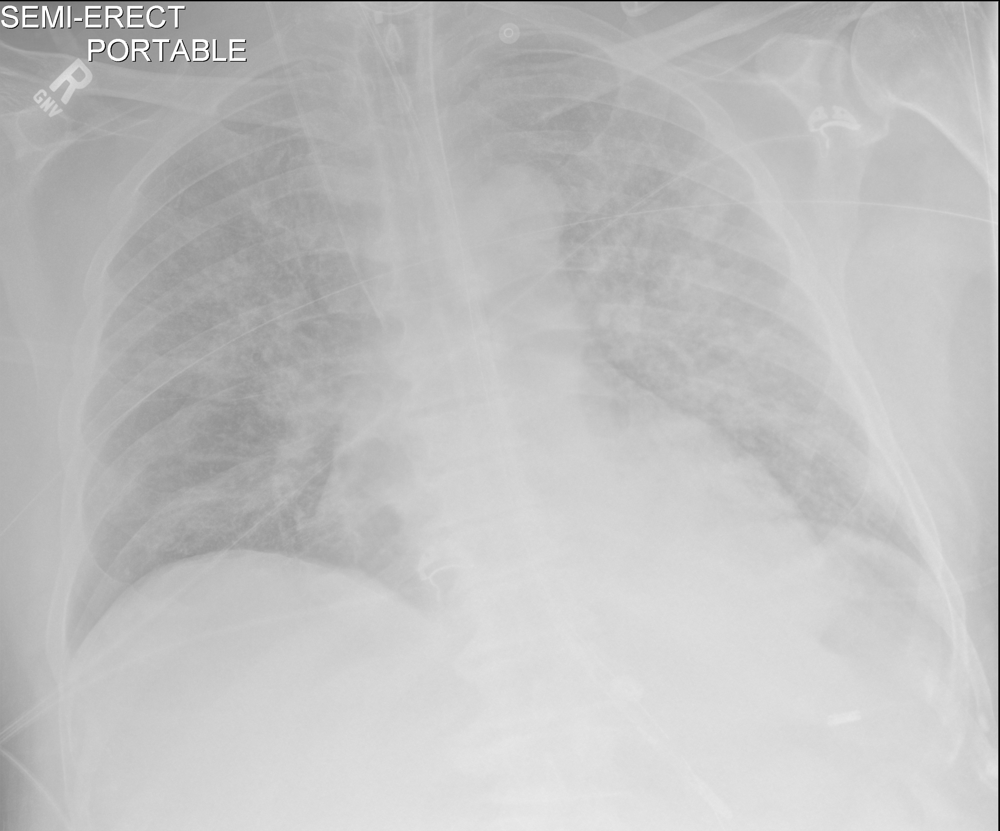

downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.125810573309217143784890529197/1.2.826.0.1.3680043.10.474.419639.118065679248589286894262755470/1.2.826.0.1.3680043.10.474.419639.222096163603758063408202308357.dcm
<class 'PIL.Image.Image'>


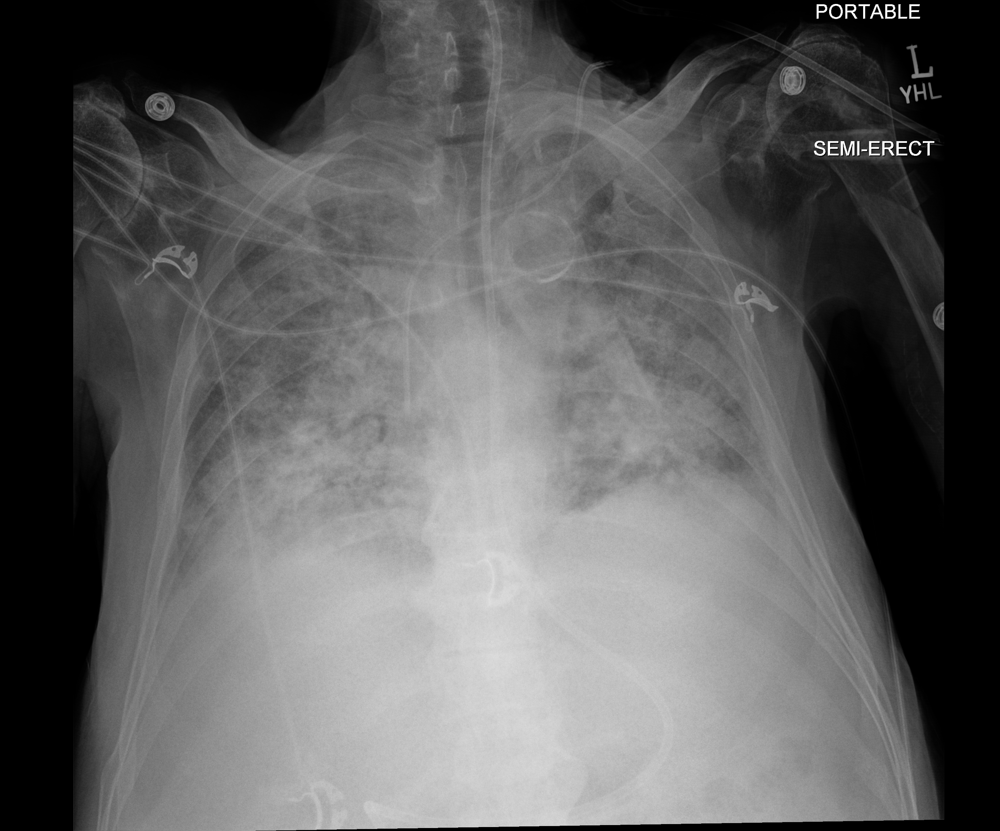

downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.161896168092474395209530500374/1.2.826.0.1.3680043.10.474.419639.241350960080622520462420009922/1.2.826.0.1.3680043.10.474.419639.145110880890384391433274781976.dcm
<class 'PIL.Image.Image'>


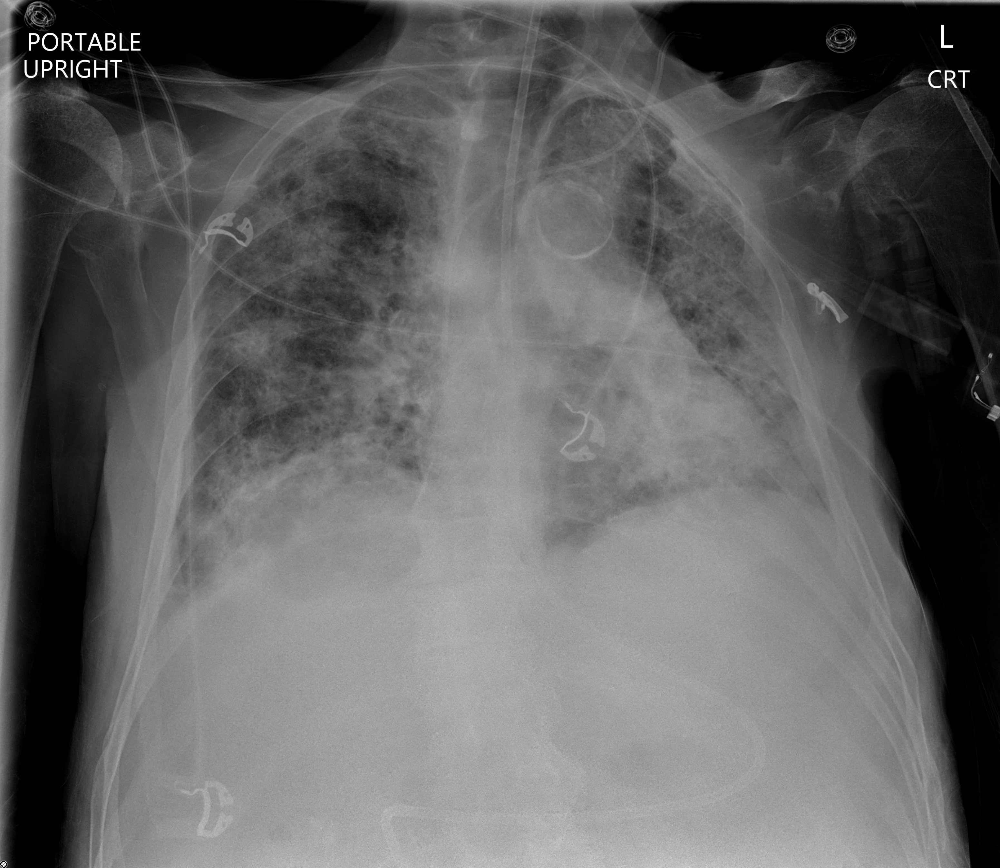

downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.274623828911318186126754873274/1.2.826.0.1.3680043.10.474.419639.251758278872580821083226828769/1.2.826.0.1.3680043.10.474.419639.129831158929213234512420327031.dcm
<class 'PIL.Image.Image'>


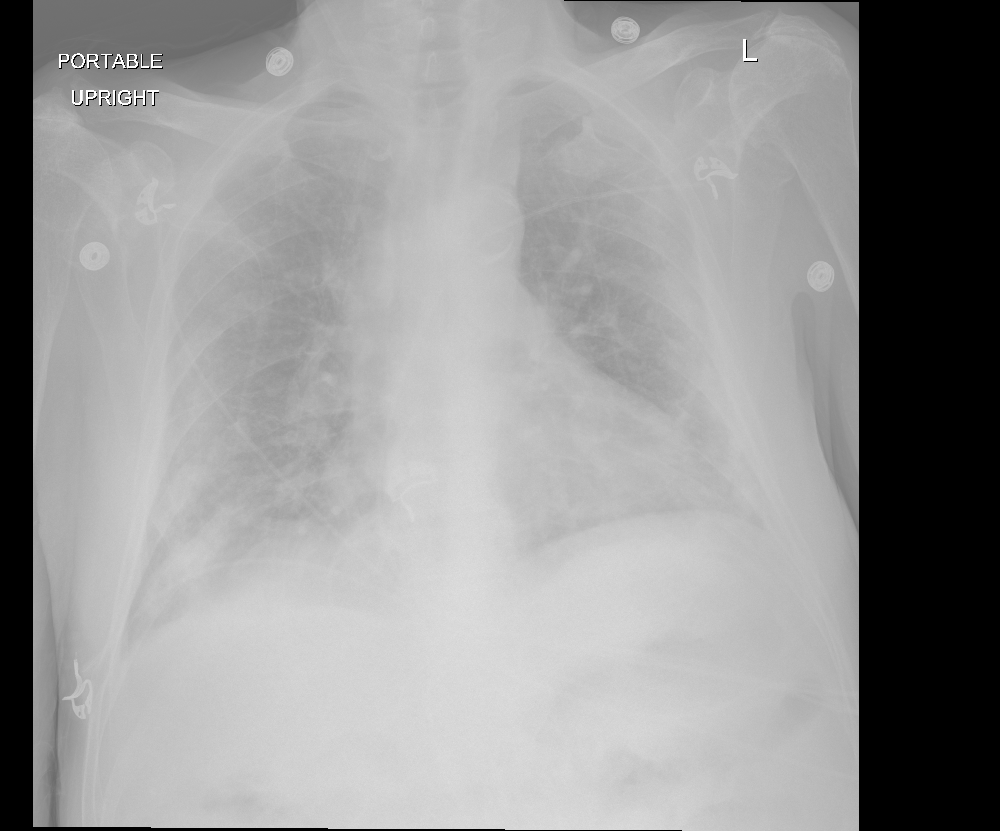

downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.118613874522385825655419409466/1.2.826.0.1.3680043.10.474.419639.305005715360473208980309632160/1.2.826.0.1.3680043.10.474.419639.532016163989758731316920279042.dcm
<class 'PIL.Image.Image'>


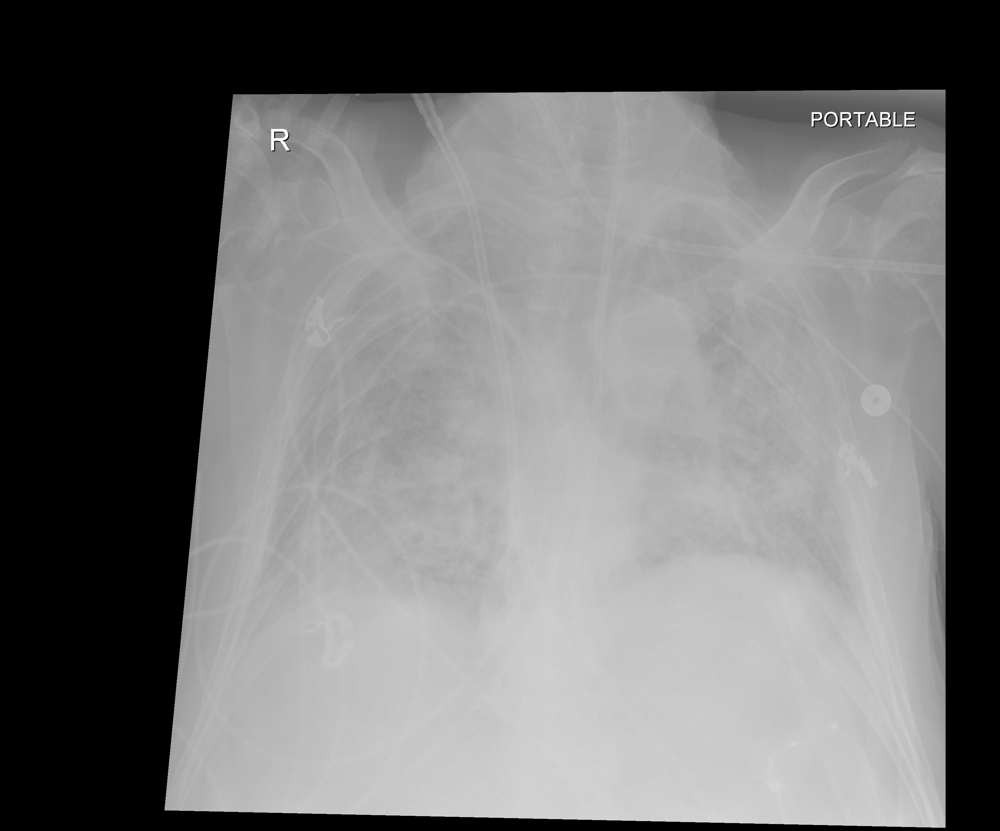

downloads/419639-005966/1.2.826.0.1.3680043.10.474.419639.136347983342456090026818822110/1.2.826.0.1.3680043.10.474.419639.116290334401168239019633666124/1.2.826.0.1.3680043.10.474.419639.120300845449893409248681861328.dcm
<class 'PIL.Image.Image'>


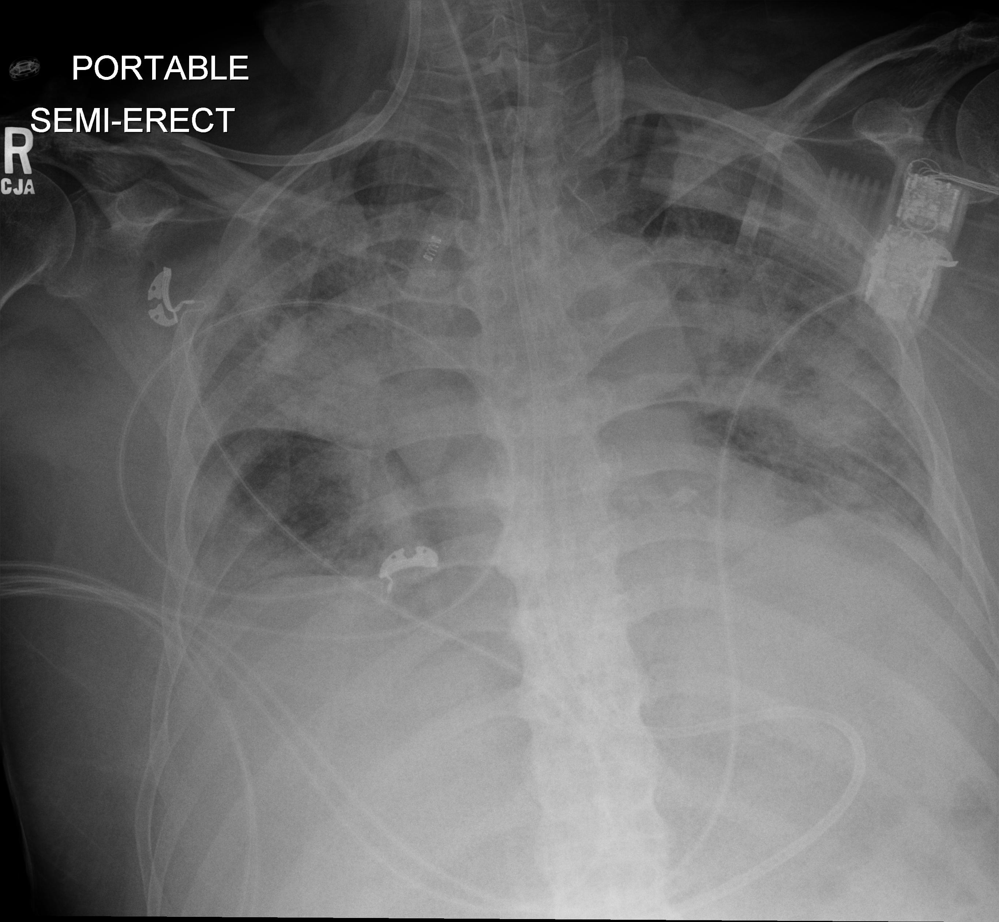

downloads/419639-005966/1.2.826.0.1.3680043.10.474.419639.238877950213975218363744768567/1.2.826.0.1.3680043.10.474.419639.199185633225969837235422780961/1.2.826.0.1.3680043.10.474.419639.338357498067445660994795729410.dcm
<class 'PIL.Image.Image'>


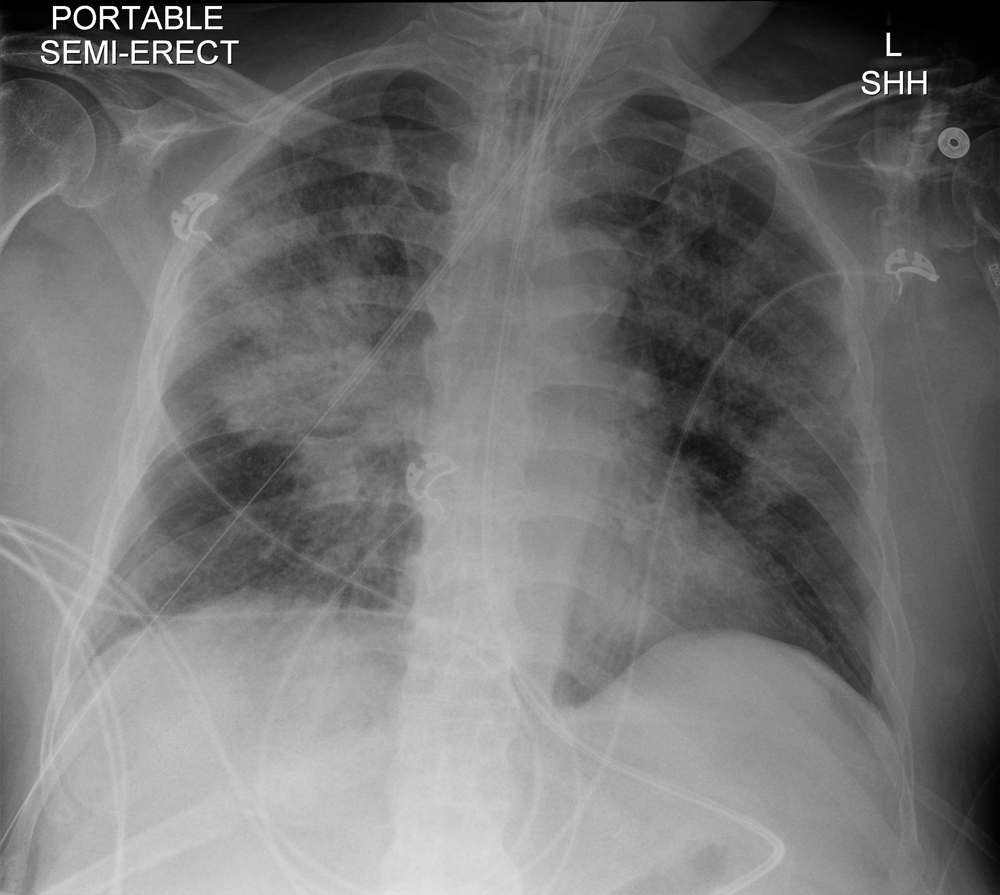

downloads/10008204-RwVMPdTu0EOZV6oE7Rml5Q/2.16.840.1.114274.1818.514395397152296418914049330214008864917/2.16.840.1.114274.1818.49815354666685421105401695275387637902/2.16.840.1.114274.1818.57232156540098663905951504146530613421.dcm
Couldn't view downloads/10008204-RwVMPdTu0EOZV6oE7Rml5Q/2.16.840.1.114274.1818.514395397152296418914049330214008864917/2.16.840.1.114274.1818.49815354666685421105401695275387637902/2.16.840.1.114274.1818.57232156540098663905951504146530613421.dcm: The following handlers are available to decode the pixel data however they are missing required dependencies: GDCM (req. GDCM), pylibjpeg (req. ).


In [ ]:
for image_file in image_files:
    print(image_file)
    ds = pydicom.dcmread(image_file)
    try:
        new_image = ds.pixel_array.astype(float)
        scaled_image = (np.maximum(new_image, 0) / new_image.max()) * 255.0
        scaled_image = np.uint8(scaled_image)
        final_image = Image.fromarray(scaled_image)
        print(type(final_image))
        display(final_image)
    except Exception as e:
        print("Couldn't view {}: {}.".format(image_file,e))

#### View the DICOM Headers
---
DICOM files have metadata elements embedded in the images. These can also be read and viewed using the `pydicom` package.

In [ ]:
ds = pydicom.dcmread(image_files[0],force=True)
display(ds)

Dataset.file_meta -------------------------------
(0002, 0000) File Meta Information Group Length  UL: 240
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Digital X-Ray Image Storage - For Presentation
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.826.0.1.3680043.10.474.419639.130092207615417146244447563736
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.826.0.1.3680043.2.1143.107.104.103.115.3.1.0
(0002, 0013) Implementation Version Name         SH: 'GDCM 3.1.0'
(0002, 0016) Source Application Entity Title     AE: 'gdcmconv'
-------------------------------------------------
(0008, 0005) Specific Character Set              CS: 'ISO_IR 100'
(0008, 0008) Image Type                          CS: ['DERIVED', 'PRIMARY']
(0008, 0016) SOP Class UID                       UI: Digital X-Ray Image Storage - For Presentation
(0008, 

In [ ]:
# Access individual elements
display(ds.file_meta)
display(ds.ImageType)
display(ds[0x0008, 0x0016])


(0002, 0000) File Meta Information Group Length  UL: 240
(0002, 0001) File Meta Information Version       OB: b'\x00\x01'
(0002, 0002) Media Storage SOP Class UID         UI: Digital X-Ray Image Storage - For Presentation
(0002, 0003) Media Storage SOP Instance UID      UI: 1.2.826.0.1.3680043.10.474.419639.130092207615417146244447563736
(0002, 0010) Transfer Syntax UID                 UI: Explicit VR Little Endian
(0002, 0012) Implementation Class UID            UI: 1.2.826.0.1.3680043.2.1143.107.104.103.115.3.1.0
(0002, 0013) Implementation Version Name         SH: 'GDCM 3.1.0'
(0002, 0016) Source Application Entity Title     AE: 'gdcmconv'

['DERIVED', 'PRIMARY']

(0008, 0016) SOP Class UID                       UI: Digital X-Ray Image Storage - For Presentation

In [ ]:
# View the dicom metadata for all files as a DataFrame
dfs = []
for image_file in image_files:
    ds = pydicom.dcmread(image_file)
    df = pd.DataFrame(ds.values())
    df[0] = df[0].apply(lambda x: pydicom.dataelem.DataElement_from_raw(x) if isinstance(x, pydicom.dataelem.RawDataElement) else x)
    df['name'] = df[0].apply(lambda x: x.name)
    df['value'] = df[0].apply(lambda x: x.value)
    df = df[['name', 'value']]
    df = df.set_index('name').T.reset_index(drop=True)
    df['filename'] = image_file
    df.drop(columns=['Pixel Data'],inplace=True) # drop the pixel data as it's too large and nonsensical to store in a DataFrame
    dfs.append(df)

In [ ]:
# Make a master dataframe for all images using only headers in all dataframes
headers = list(set.intersection(*map(set,dfs)))
df = pd.concat([df[headers] for df in dfs])
df.set_index('filename',inplace=True)


In [ ]:
display(df)

name,Series Number,Study Date,Accession Number,SOP Instance UID,Exposure Index,SOP Class UID,Bits Allocated,Pixel Representation,Image Type,Bits Stored,...,Series Time,Columns,Patient's Age,Body Part Examined,De-identification Method,Content Time,Samples per Pixel,Specific Character Set,Series Date,KVP
filename,,,,,,,,,,,,,,,,,,,,,
downloads/419639-003484/1.2.826.0.1.3680043.10.474.419639.210778054999760359188417916669/1.2.826.0.1.3680043.10.474.419639.485051506367402929274868149596/1.2.826.0.1.3680043.10.474.419639.130092207615417146244447563736.dcm,1,20111013,12239,1.2.826.0.1.3680043.10.474.419639.130092207615...,85.87,1.2.840.10008.5.1.4.1.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,163515.54252,3032,070Y,CHEST,RSNA Covid-19 Dataset Default,163515.54252,1,ISO_IR 100,20111013,87.0
downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.125810573309217143784890529197/1.2.826.0.1.3680043.10.474.419639.118065679248589286894262755470/1.2.826.0.1.3680043.10.474.419639.222096163603758063408202308357.dcm,1,20170529,19530,1.2.826.0.1.3680043.10.474.419639.222096163603...,245.05,1.2.840.10008.5.1.4.1.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,090416.195916,3032,070Y,CHEST,RSNA Covid-19 Dataset Default,090416.195916,1,ISO_IR 100,20170529,90.0
downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.161896168092474395209530500374/1.2.826.0.1.3680043.10.474.419639.241350960080622520462420009922/1.2.826.0.1.3680043.10.474.419639.145110880890384391433274781976.dcm,1,20170528,19536,1.2.826.0.1.3680043.10.474.419639.145110880890...,200.0,1.2.840.10008.5.1.4.1.1.1.1,16,0,"[DERIVED, PRIMARY, ]",12,...,171056.567,3103,070Y,CHEST,RSNA Covid-19 Dataset Default,171609.043,1,ISO_IR 100,20170528,100.0
downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.274623828911318186126754873274/1.2.826.0.1.3680043.10.474.419639.251758278872580821083226828769/1.2.826.0.1.3680043.10.474.419639.129831158929213234512420327031.dcm,1,20170503,16795,1.2.826.0.1.3680043.10.474.419639.129831158929...,120.17,1.2.840.10008.5.1.4.1.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,155737.445712,3032,070Y,CHEST,RSNA Covid-19 Dataset Default,155737.445712,1,ISO_IR 100,20170503,85.0
downloads/419639-004486/1.2.826.0.1.3680043.10.474.419639.118613874522385825655419409466/1.2.826.0.1.3680043.10.474.419639.305005715360473208980309632160/1.2.826.0.1.3680043.10.474.419639.532016163989758731316920279042.dcm,1,20170605,20186,1.2.826.0.1.3680043.10.474.419639.532016163989...,182.38,1.2.840.10008.5.1.4.1.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,102738.306306,3032,070Y,CHEST,RSNA Covid-19 Dataset Default,102738.306306,1,ISO_IR 100,20170605,97.0
downloads/419639-005966/1.2.826.0.1.3680043.10.474.419639.136347983342456090026818822110/1.2.826.0.1.3680043.10.474.419639.116290334401168239019633666124/1.2.826.0.1.3680043.10.474.419639.120300845449893409248681861328.dcm,1,20110510,24178,1.2.826.0.1.3680043.10.474.419639.120300845449...,153.86,1.2.840.10008.5.1.4.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,115907.728007,2731,070Y,CHEST,RSNA Covid-19 Dataset Default,115907.728007,1,ISO_IR 100,20110510,85.0
downloads/419639-005966/1.2.826.0.1.3680043.10.474.419639.238877950213975218363744768567/1.2.826.0.1.3680043.10.474.419639.199185633225969837235422780961/1.2.826.0.1.3680043.10.474.419639.338357498067445660994795729410.dcm,1,20110508,24164,1.2.826.0.1.3680043.10.474.419639.338357498067...,235.73,1.2.840.10008.5.1.4.1.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,203133.445523,2813,070Y,CHEST,RSNA Covid-19 Dataset Default,203133.445523,1,ISO_IR 100,20110508,90.0
downloads/10008204-RwVMPdTu0EOZV6oE7Rml5Q/2.16.840.1.114274.1818.514395397152296418914049330214008864917/2.16.840.1.114274.1818.49815354666685421105401695275387637902/2.16.840.1.114274.1818.57232156540098663905951504146530613421.dcm,2,19600101,,2.16.840.1.114274.1818.57232156540098663905951...,281.28,1.2.840.10008.5.1.4.1.1.1,16,0,"[DERIVED, PRIMARY]",12,...,101126.158,3032,070Y,PORT CHEST,"[Basic Application Confidentiality Profile, Re...",101126,1,,1960010

In [ ]:
## Export the file metadata as a TSV file
filename = "MIDRC_DICOM_metadata.tsv"
df.to_csv(filename, sep='\t')


## The End
---
If you have any questions related to this notebook don't hesitate to reach out to the MIDRC Helpdesk at midrc-support@datacommons.io or the author directly at cgmeyer@uchicago.edu

Happy data wrangling!